In [1]:
import os
import pandas as pd
import numpy as np
import sys
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.io import read_image


sys.path.insert(0, '../../scripts/')

from helpers import miscellaneous as m
from helpers import preprocessing as prep
from helpers import plotters
from loaders.data_loader import CustomImageDataset
from nets.get_net import get_net
from losses.get_loss import get_optimizer, get_criterion


CONFIG = m.get_config()
MODEL_PATH = '../../models/'

In [2]:
df  = pd.read_csv('../../data/annotations/test_labels.csv')
df.head()

,Unnamed: 0,filenames,target
0,653,DezGes50_dp.jpg,0
1,518,OktFx2_dp.jpg,1
2,251,4DCTGes10_dp.jpg,0
3,301,JanFx19_dp.jpg,1
4,499,NovGes15_dp.jpg,0


### Load Model

In [19]:
MODEL_NAME = 'DenseNet121_LR0.0019676087078530735_CRFocal Loss_TRAugment_Normalize_OPAdamW_BS12_EP40__ID_02927019-cdb7-4c2e-82c0-4523867cac74.pth'
model = get_net("DenseNet121")

TRANSFORMER_NAME = "Augment_Normalize"
BATCH_SIZE = 16
EPOCHS = 20
CRITERION = "Focal Loss"
OPTIMIZER = "AdamW"

criterion = get_criterion("Focal Loss")
# device = torch.device('cuda:2' if torch.cuda.is_available() else 'cpu')
transformer = prep.get_transformer(TRANSFORMER_NAME)[0]

model = m.load_model(model, MODEL_PATH, MODEL_NAME)

[INFO] Selected DenseNet121 as Model, requires min. 224x224 Input
[INFO] Loss: Focal Loss
[INFO] Transformer: Augment_Normalize


In [20]:
test_data = CustomImageDataset(annotations_file='../' + CONFIG['DATA_DIR_TESTSET'], img_dir='../' + CONFIG['DATA_DIR_FLATTENED_FC'], transform=transformer)

test_dataloader = DataLoader(test_data, batch_size=1, shuffle=False)

In [21]:
df_testset = pd.read_csv('../' + CONFIG['DATA_DIR_TESTSET'])
df_testset.head()

,Unnamed: 0,filenames,target
0,653,DezGes50_dp.jpg,0
1,518,OktFx2_dp.jpg,1
2,251,4DCTGes10_dp.jpg,0
3,301,JanFx19_dp.jpg,1
4,499,NovGes15_dp.jpg,0


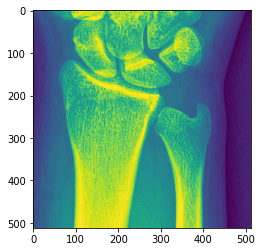

In [22]:
import matplotlib.pyplot as plt
tensor_to_image = transforms.Compose([
    transforms.ToPILImage(),
])

for data in test_dataloader:
    plt.imshow(data[0].squeeze(0).squeeze(0))
    break

In [23]:
y_true = []
y_pred = []
y_proba = None
all_scores = []
all_predictions = []
with torch.no_grad():
    for data in test_dataloader:


        inputs, labels = data[0], data[1]

        outputs = model(inputs)

        scores, predictions = torch.max(outputs.data, 1)
        all_scores.append(scores)
        all_predictions.append(predictions)

        if y_proba is None:
            y_proba = outputs.cpu()
        else:
            y_proba = np.vstack((y_proba, outputs.cpu()))

        for i in labels.tolist():
            y_true.append(i)
        for j in predictions.tolist():
            y_pred.append(j)

In [24]:
df_result = pd.DataFrame()
df_result['true'] = y_true
df_result['pred'] = y_pred
df_result['proba_n'] = y_proba[:,0]
df_result['proba_p'] = y_proba[:,1]
df_result.head()

,true,pred,proba_n,proba_p
0,0,0,1.999846,-2.010432
1,1,1,-1.389491,1.390991
2,0,0,0.932767,-0.930815
3,1,1,-1.665242,1.683180
4,0,0,1.510916,-1.533082


### Get Top N False Positives

In [27]:
def GradCam():
    img_path = os.path.join('../' + CONFIG['DATA_DIR_FLATTENED_FC'], df_testset.filenames[i])
    image = read_image(img_path).float()
    plotters.grad_cam(model, [model.features[-1]], image, transformer_name='Augment_Normalize')

In [32]:
N = 10
top_false_positives = df_result[(df_result['true'] == 0) & (df_result['pred'] == 1)].sort_values(by='proba_p', ascending=False).index[:N]

for i, data in enumerate(test_data):
    if i in top_false_positives:
        plt.figure(figsize=(9,9))
        plt.imshow(data[0].squeeze(0).squeeze(0))
        name = df.iloc[i]['filenames']
        plt.title(f'FP, Image {name}, Proba_P {df_result.iloc[i]["proba_p"]}')
        plt.show()
        GradCam()

### Get Top N False Negatives

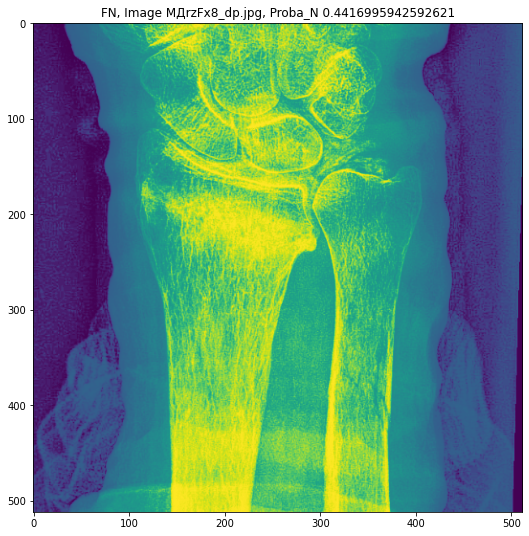

[INFO] Transformer: Augment_Normalize


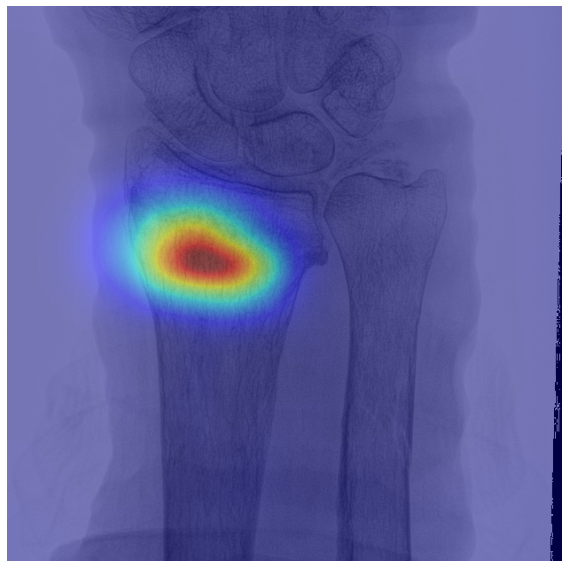

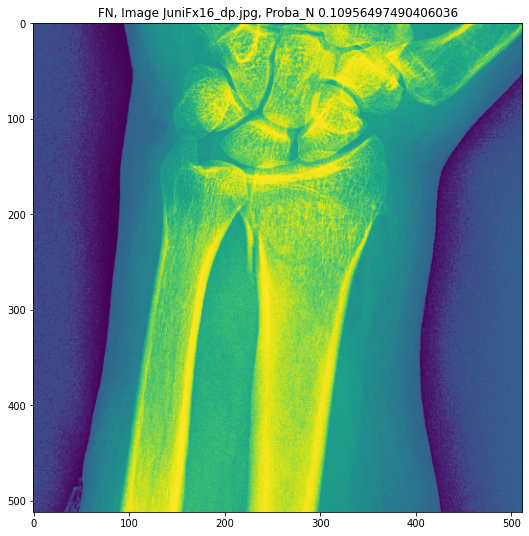

[INFO] Transformer: Augment_Normalize


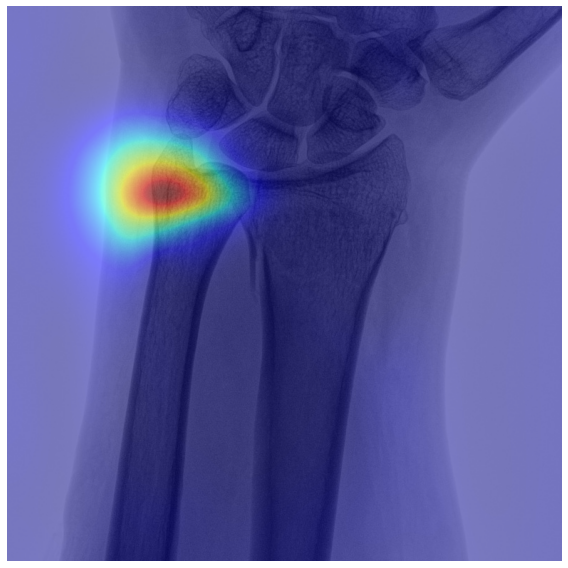

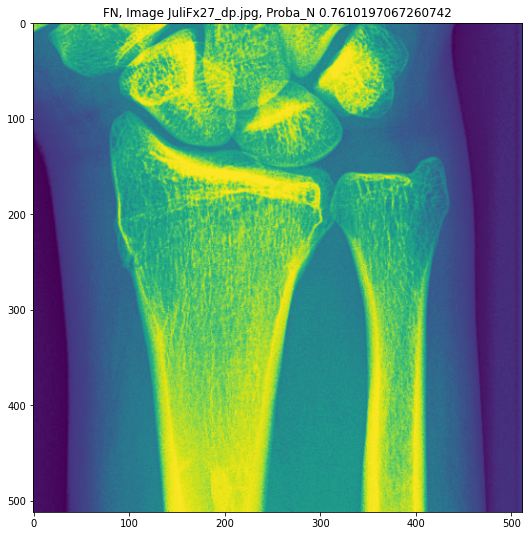

[INFO] Transformer: Augment_Normalize


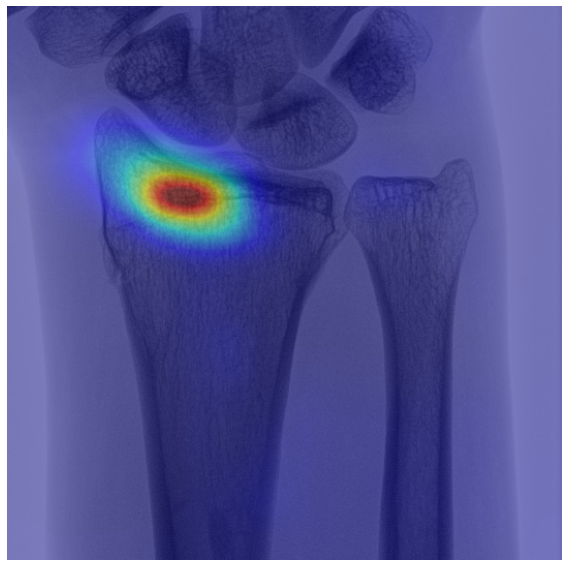

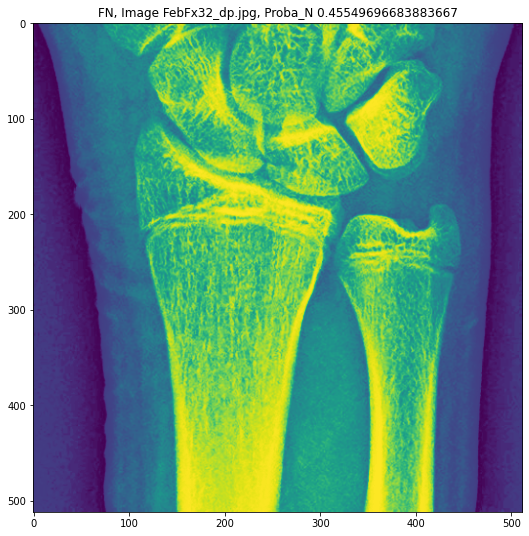

[INFO] Transformer: Augment_Normalize


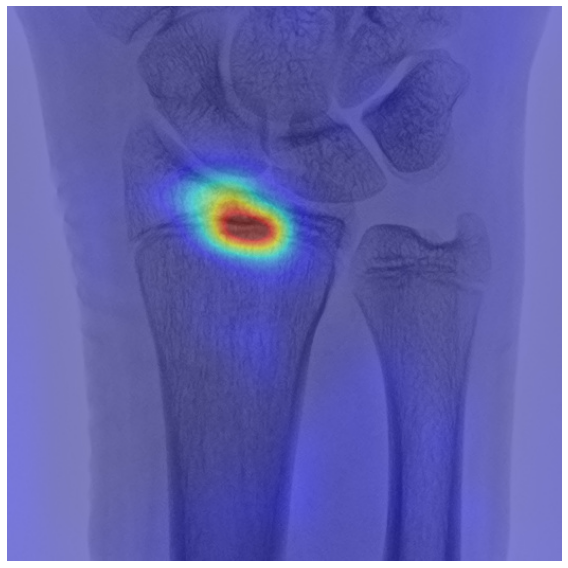

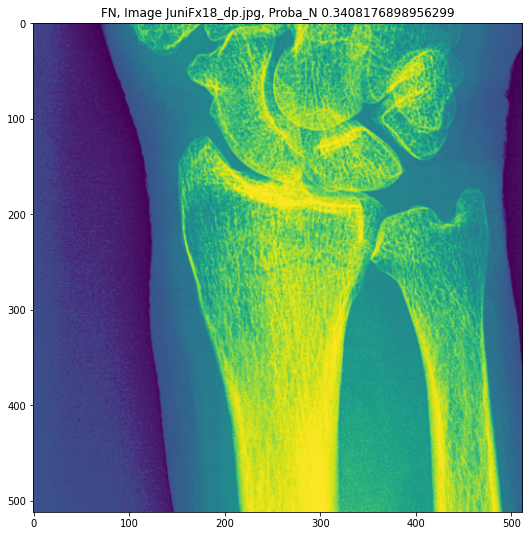

[INFO] Transformer: Augment_Normalize


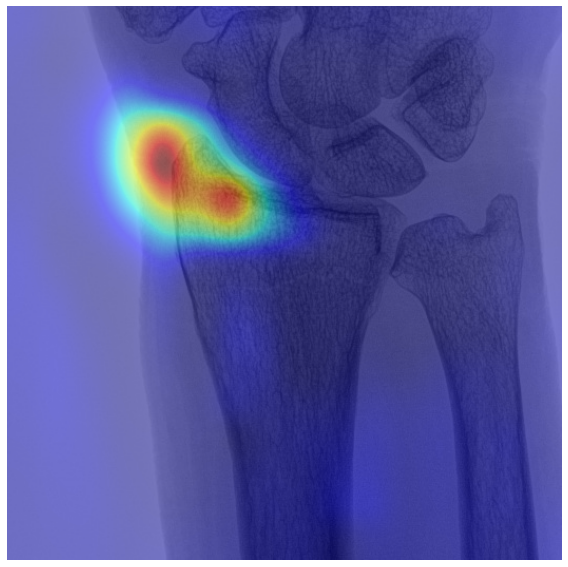

In [29]:
N = 10
top_false_negatives = df_result[(df_result['true'] == 1) & (df_result['pred'] == 0)].sort_values(by='proba_n', ascending=False).index[:N]

for i, data in enumerate(test_data):
    if i in top_false_negatives:
        plt.figure(figsize=(9,9))
        plt.imshow(data[0].squeeze(0).squeeze(0))
        name = df.iloc[i]['filenames']
        plt.title(f'FN, Image {name}, Proba_N {df_result.iloc[i]["proba_n"]}')
        plt.show()
        GradCam()

In [12]:
len(df_result[(df_result['true'] == 1) & (df_result['pred'] == 0)].sort_values(by='proba_n', ascending=False))

5

#### Get top True Positives

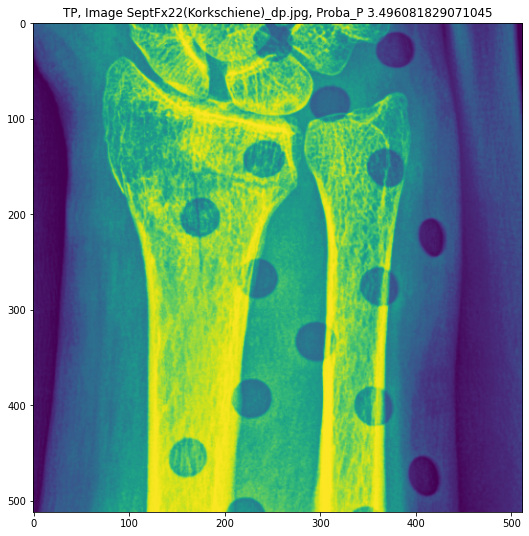

[INFO] Transformer: Augment_Normalize


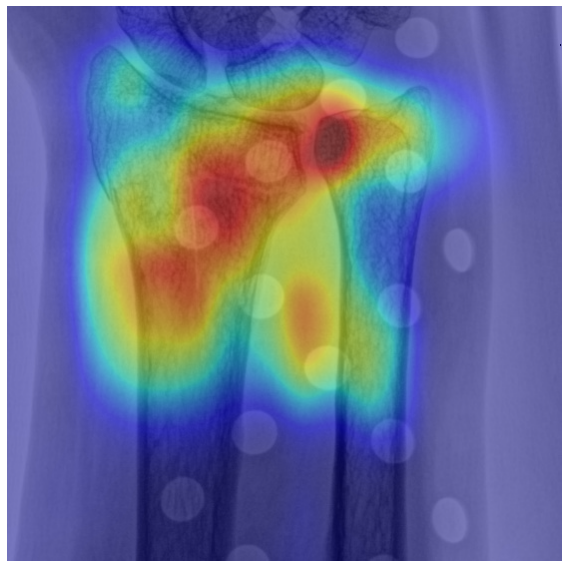

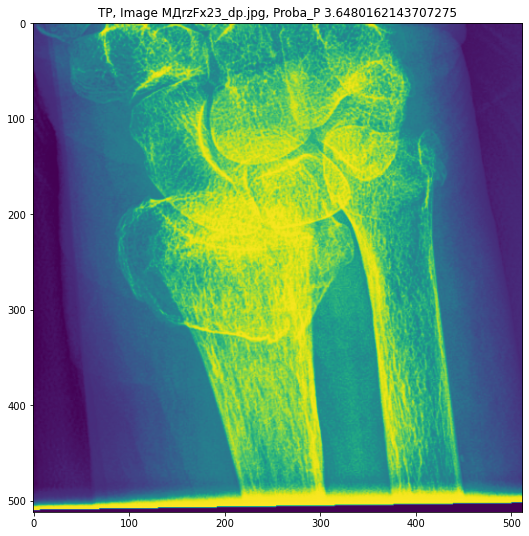

[INFO] Transformer: Augment_Normalize


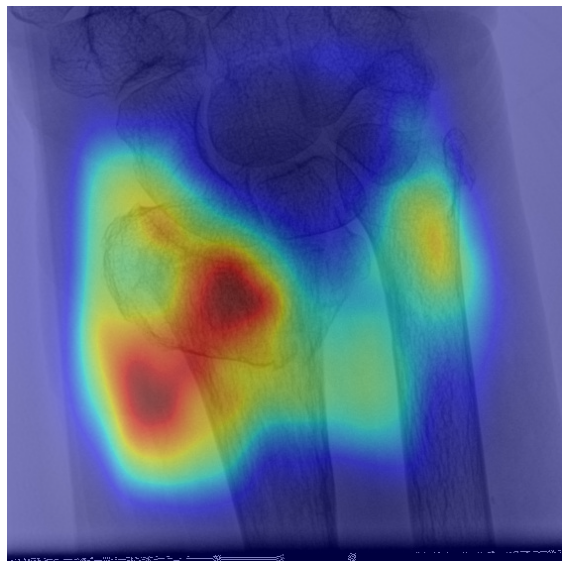

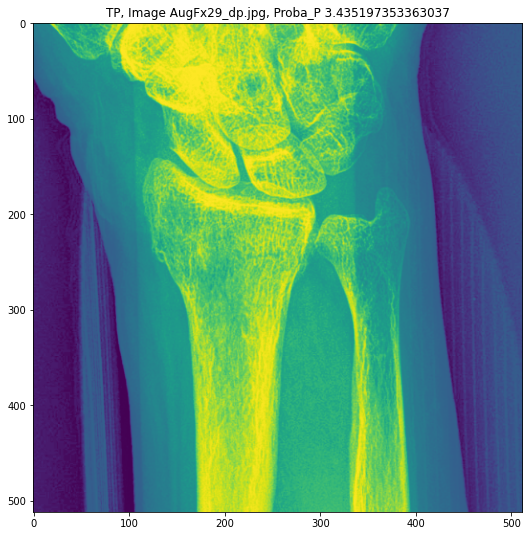

[INFO] Transformer: Augment_Normalize


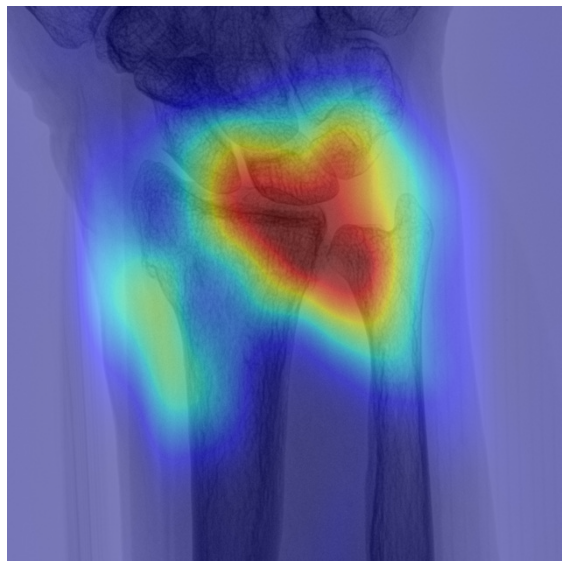

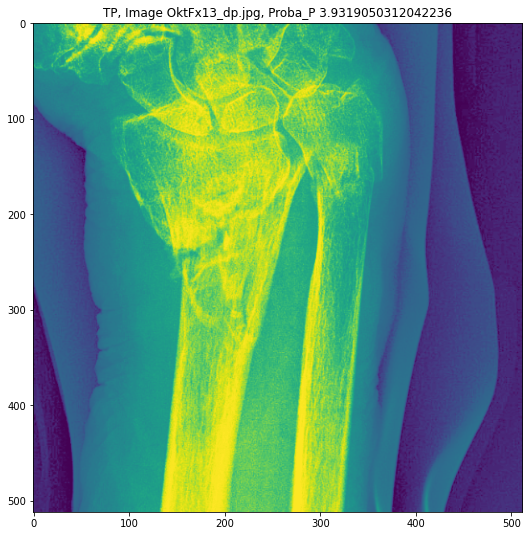

[INFO] Transformer: Augment_Normalize


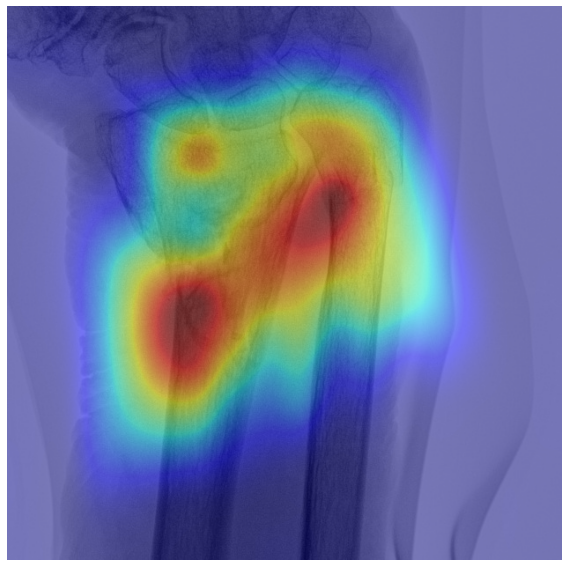

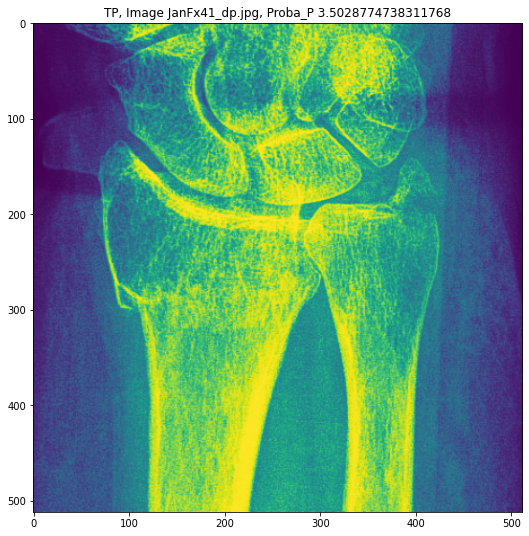

[INFO] Transformer: Augment_Normalize


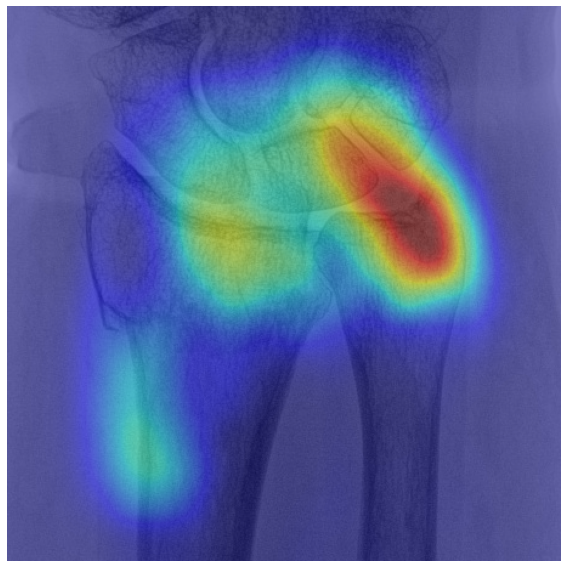

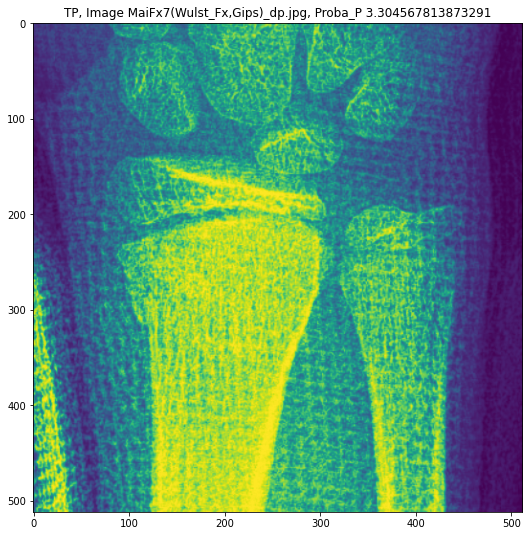

[INFO] Transformer: Augment_Normalize


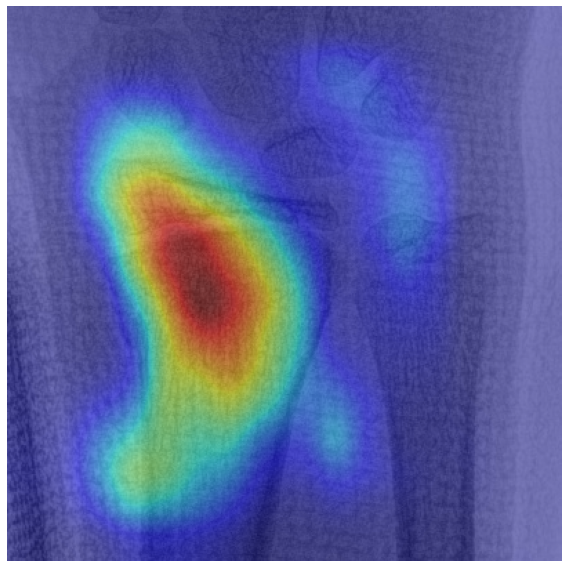

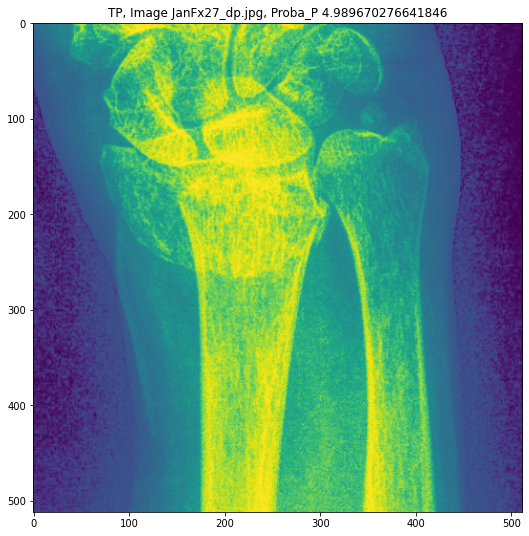

[INFO] Transformer: Augment_Normalize


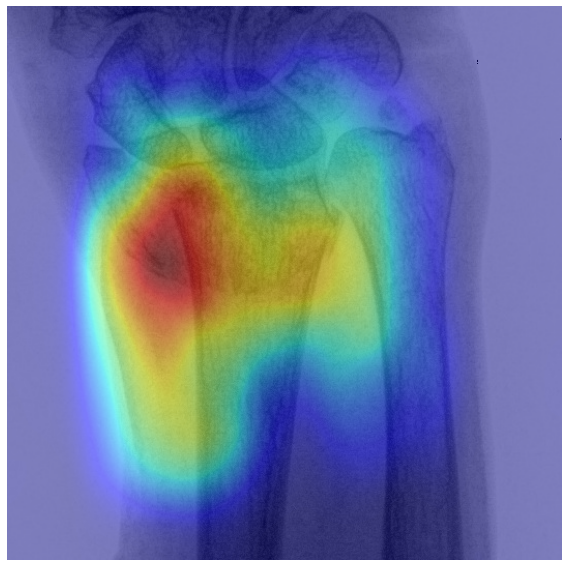

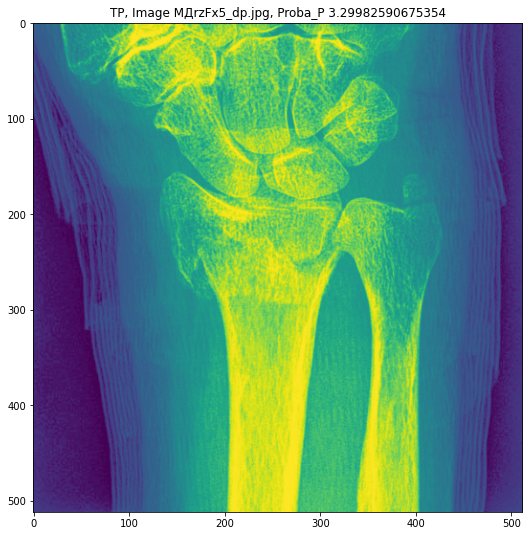

[INFO] Transformer: Augment_Normalize


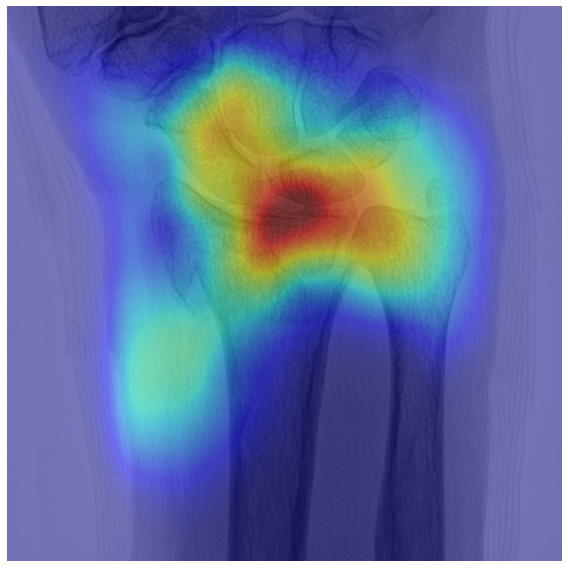

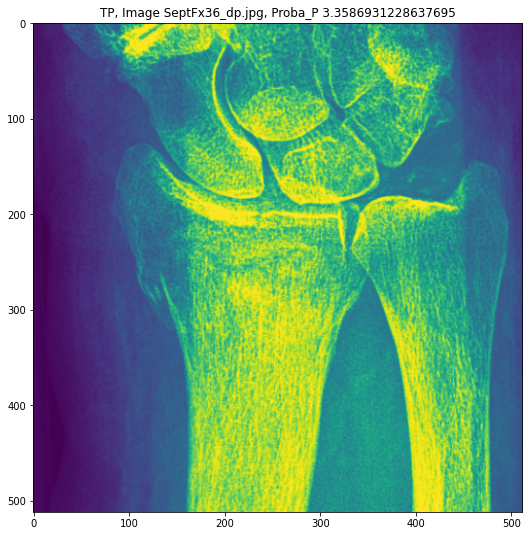

[INFO] Transformer: Augment_Normalize


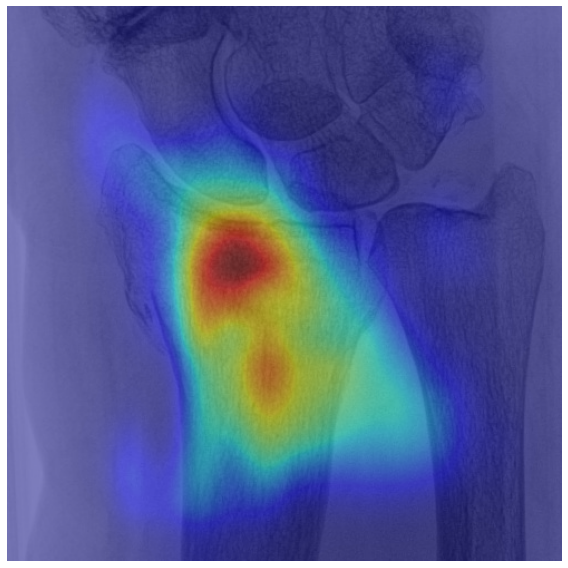

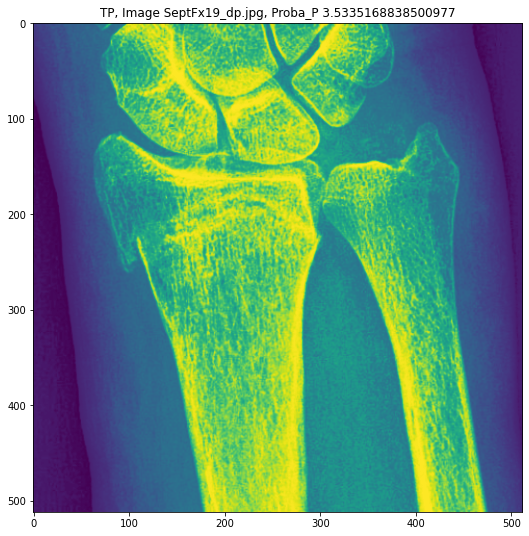

[INFO] Transformer: Augment_Normalize


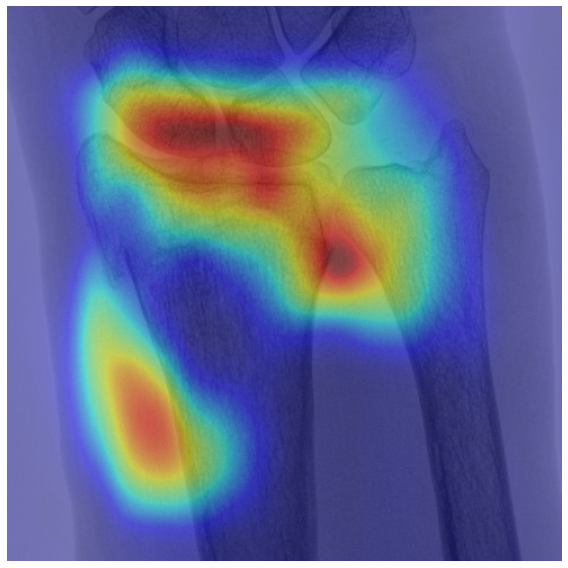

In [30]:
N = 10
top_true_positives = df_result[(df_result['true'] == 1) & (df_result['pred'] == 1)].sort_values(by='proba_p', ascending=False).index[:N]

for i, data in enumerate(test_data):
    if i in top_true_positives:
        plt.figure(figsize=(9,9))
        plt.imshow(data[0].squeeze(0).squeeze(0))
        name = df.iloc[i]['filenames']
        plt.title(f'TP, Image {name}, Proba_P {df_result.iloc[i]["proba_p"]}')
        plt.show()
        GradCam()

In [14]:
df.iloc[top_true_positives[1]]

Unnamed: 0               652
filenames     OktFx13_dp.jpg
target                     1
Name: 76, dtype: object

 ### Get Top True Negatives

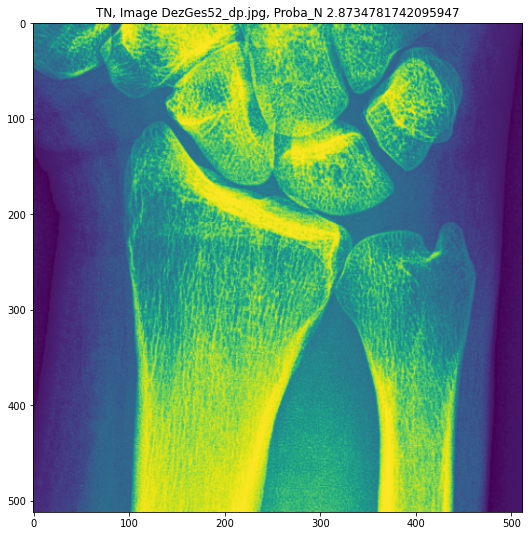

[INFO] Transformer: Augment_Normalize


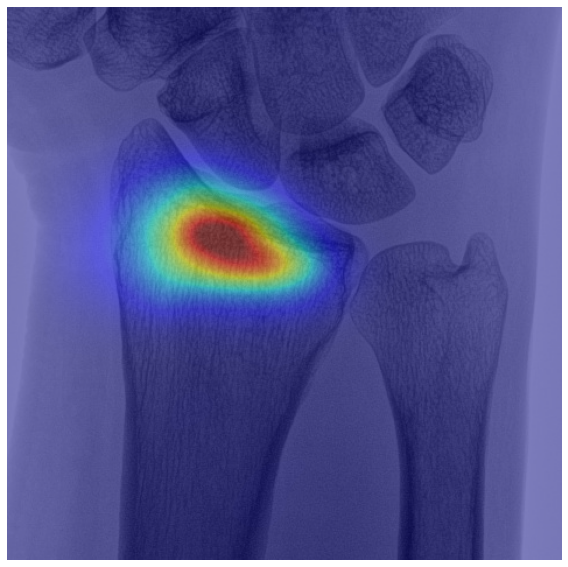

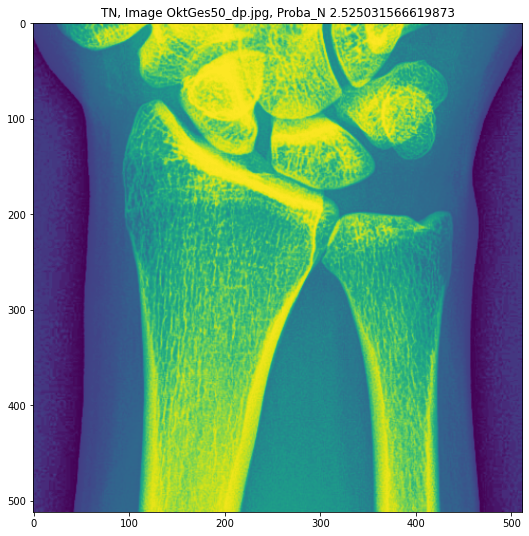

[INFO] Transformer: Augment_Normalize


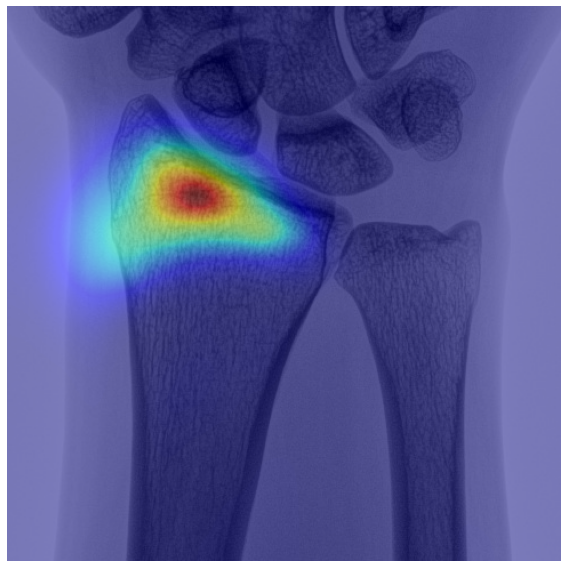

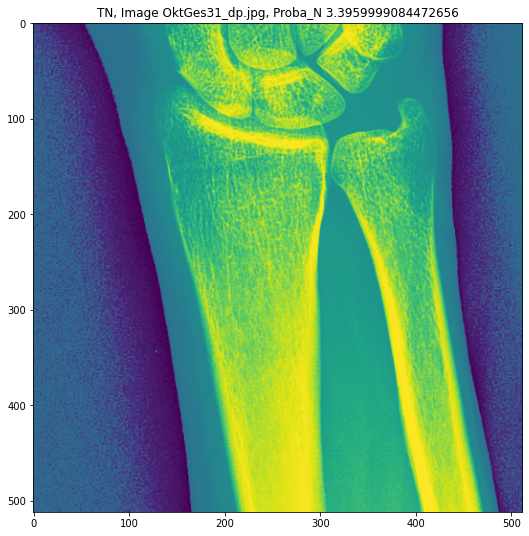

[INFO] Transformer: Augment_Normalize


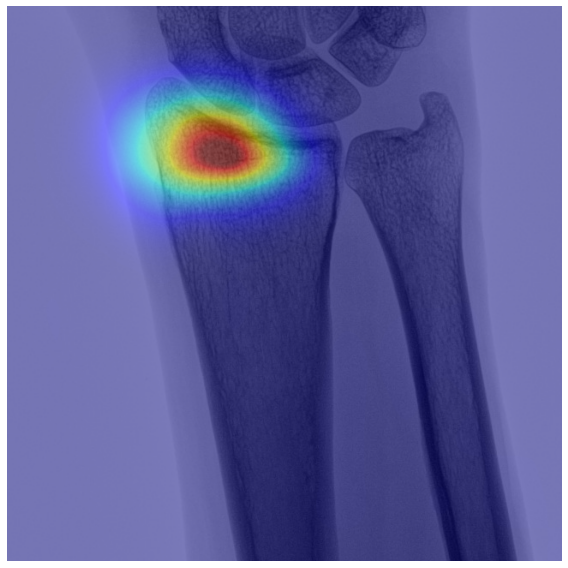

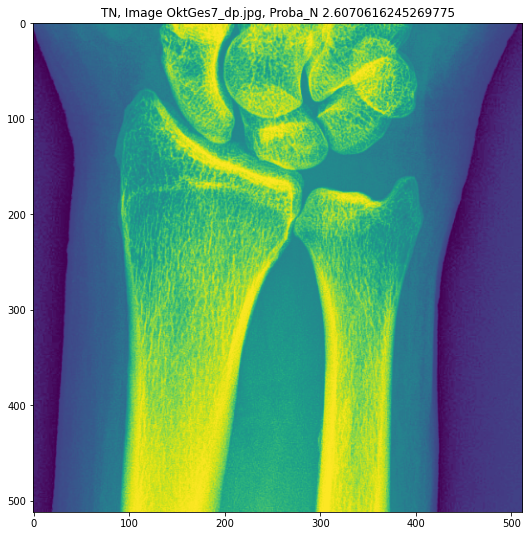

[INFO] Transformer: Augment_Normalize


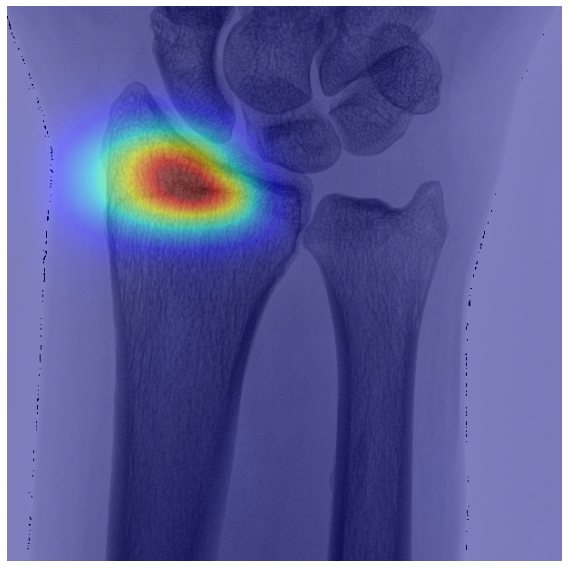

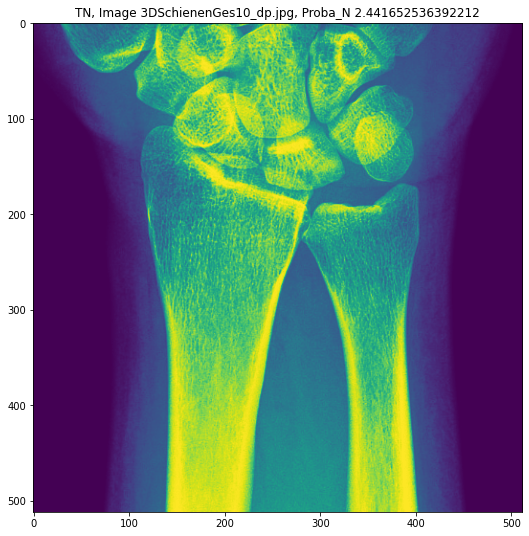

[INFO] Transformer: Augment_Normalize


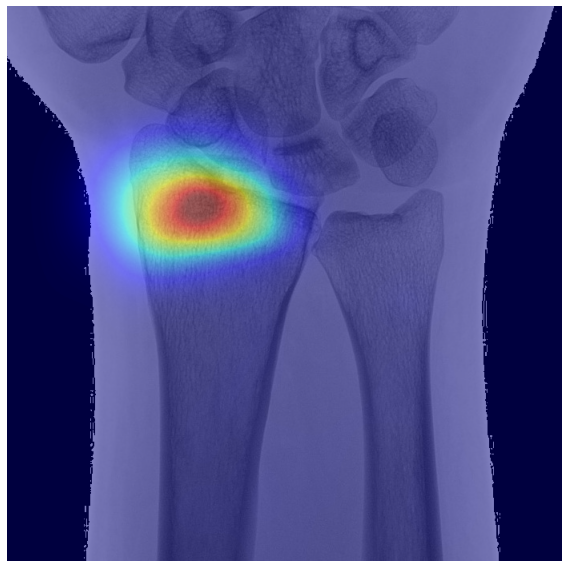

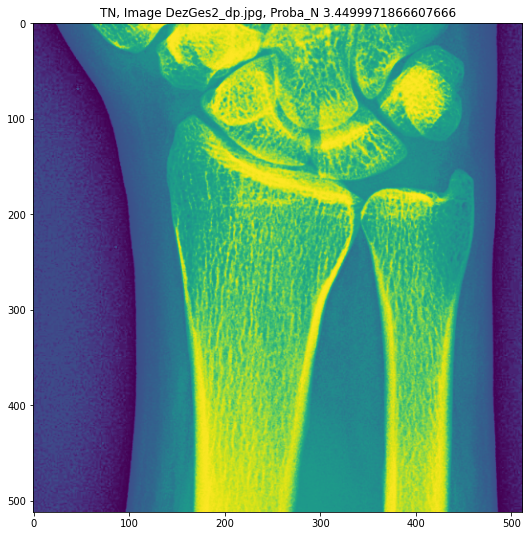

[INFO] Transformer: Augment_Normalize


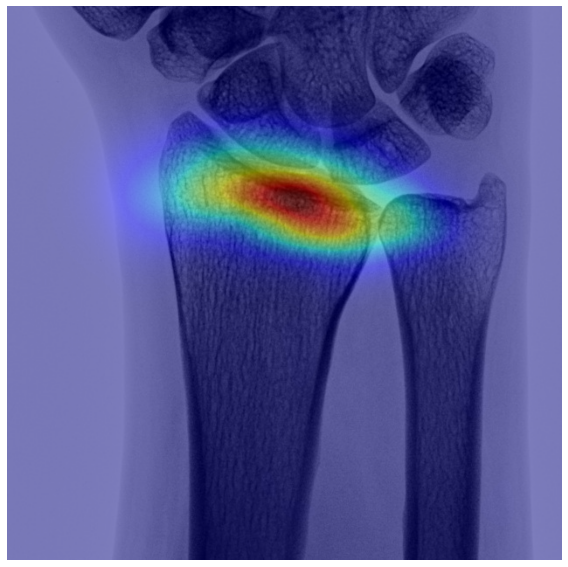

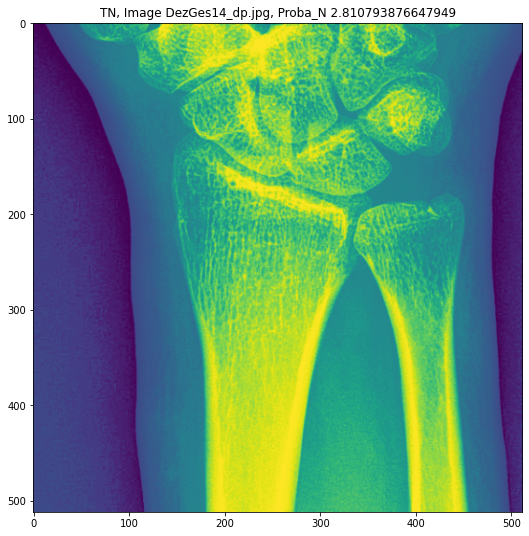

[INFO] Transformer: Augment_Normalize


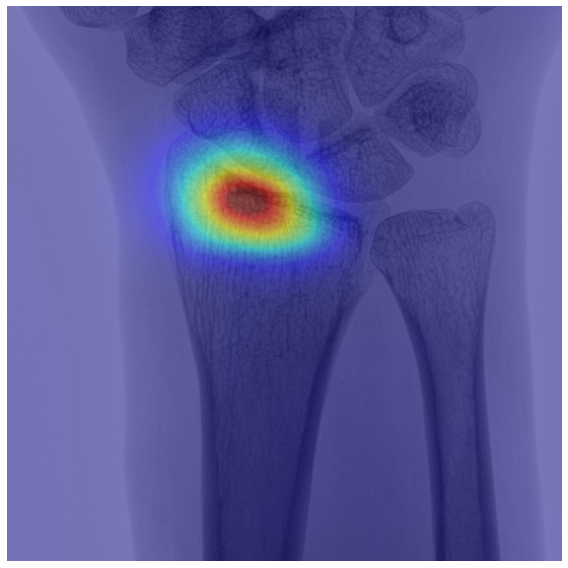

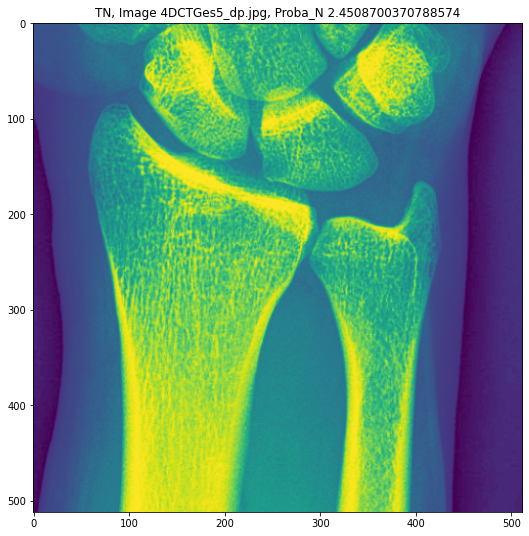

[INFO] Transformer: Augment_Normalize


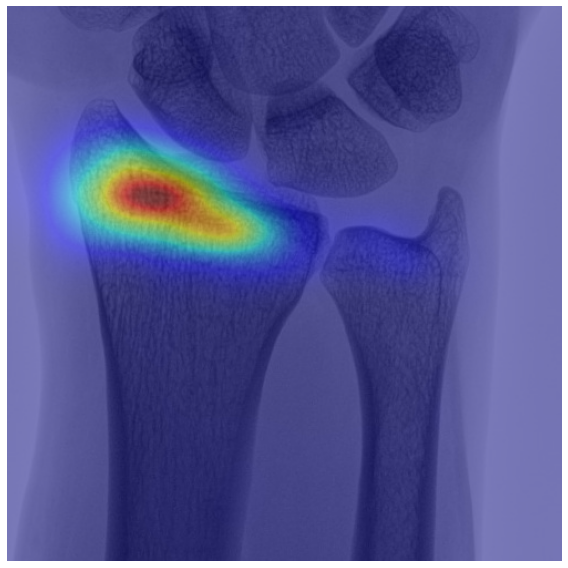

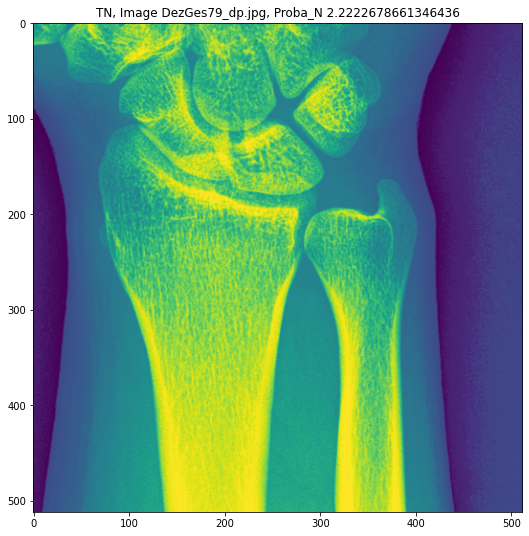

[INFO] Transformer: Augment_Normalize


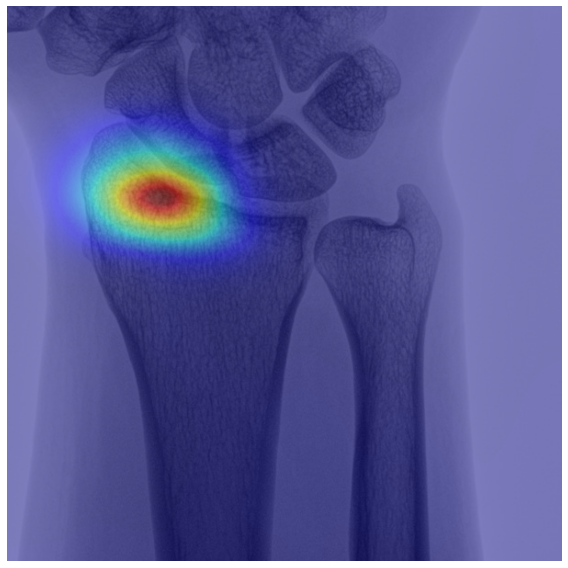

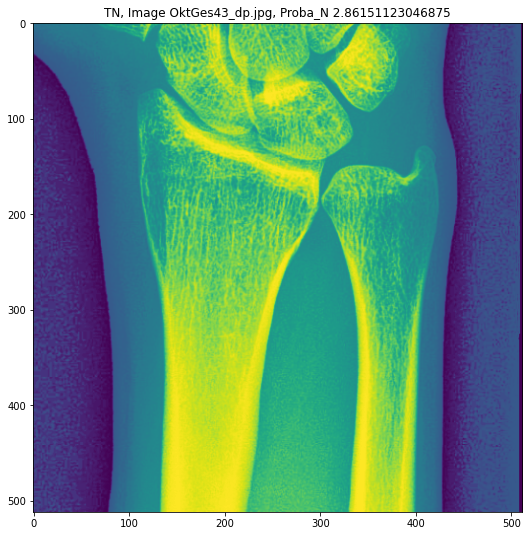

[INFO] Transformer: Augment_Normalize


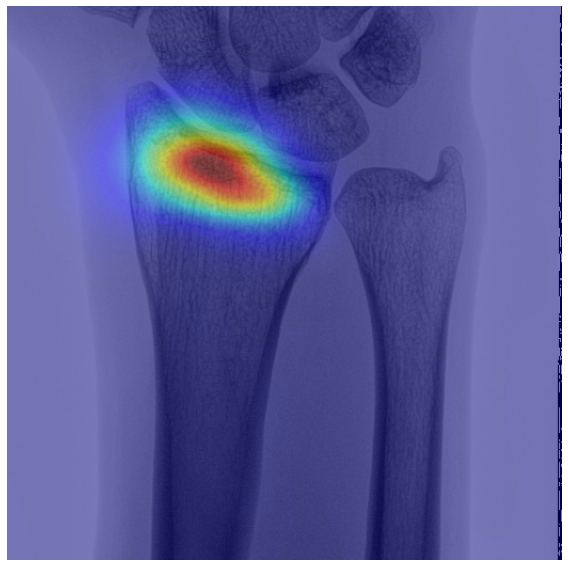

In [31]:
N = 10
top_true_positives = df_result[(df_result['true'] == 0) & (df_result['pred'] == 0)].sort_values(by='proba_n', ascending=False).index[:N]

for i, data in enumerate(test_data):
    if i in top_true_positives:
        plt.figure(figsize=(9,9))
        plt.imshow(data[0].squeeze(0).squeeze(0))
        name = df.iloc[i]['filenames']
        plt.title(f'TN, Image {name}, Proba_N {df_result.iloc[i]["proba_n"]}')
        plt.show()
        GradCam()

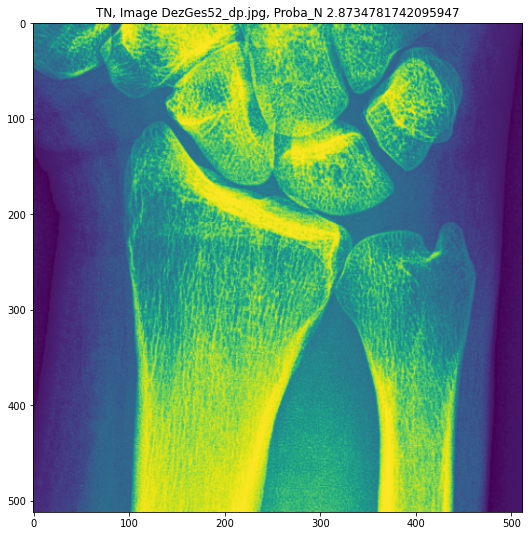

[INFO] Transformer: Augment_Normalize


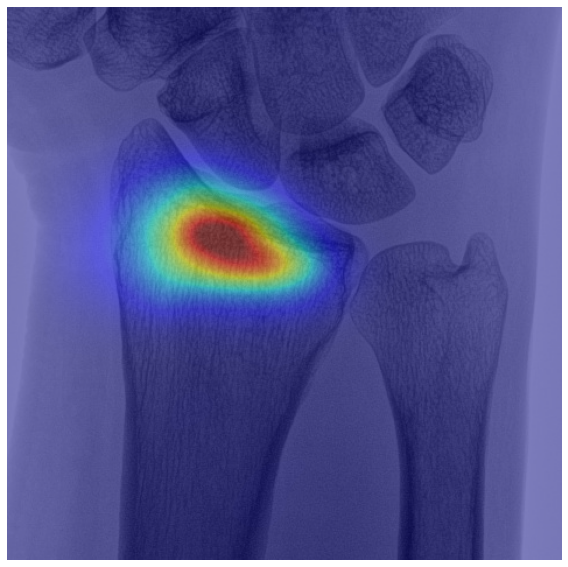

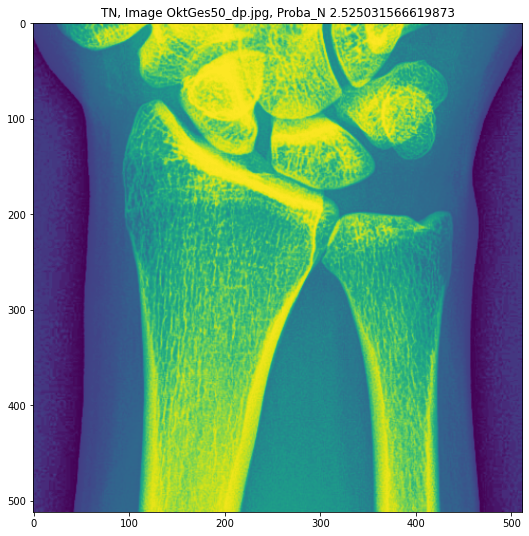

[INFO] Transformer: Augment_Normalize


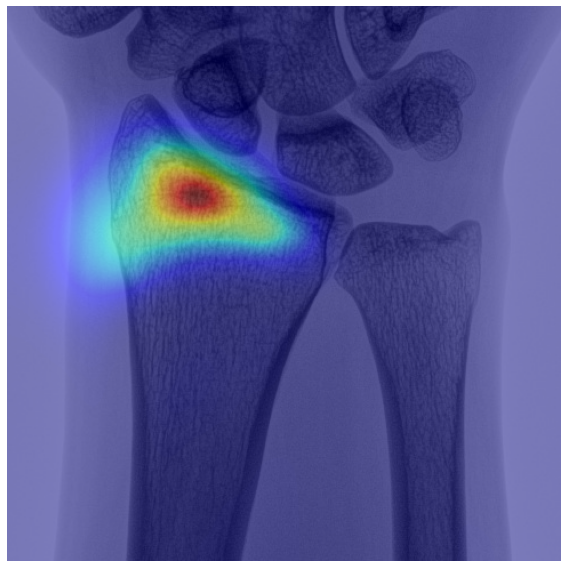

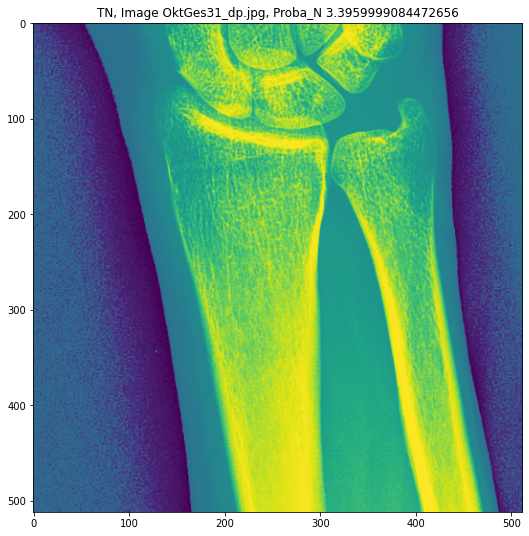

[INFO] Transformer: Augment_Normalize


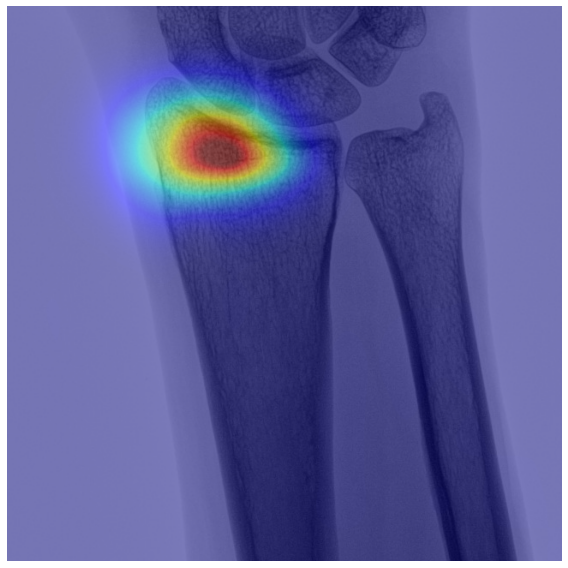

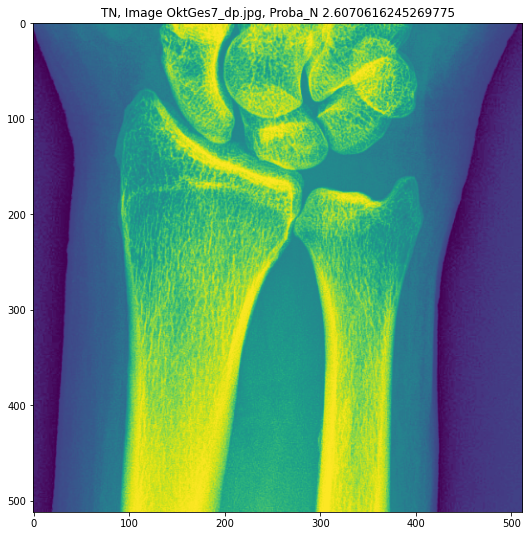

[INFO] Transformer: Augment_Normalize


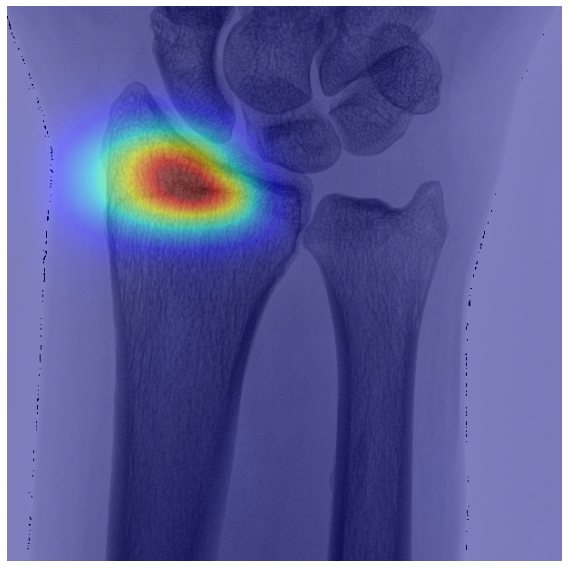

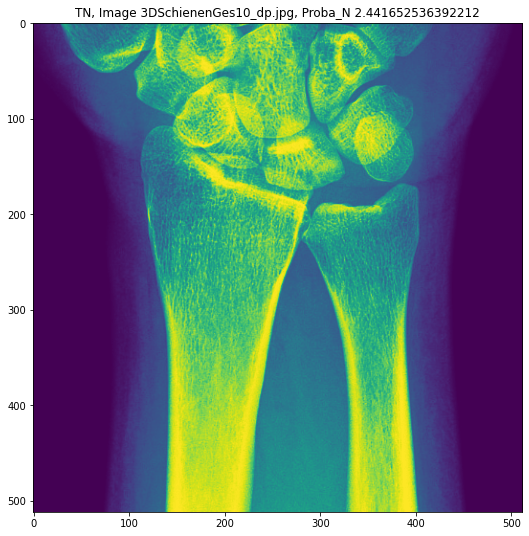

[INFO] Transformer: Augment_Normalize


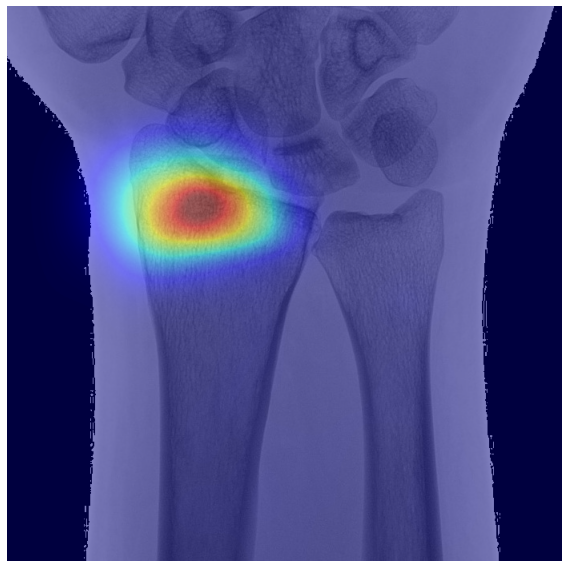

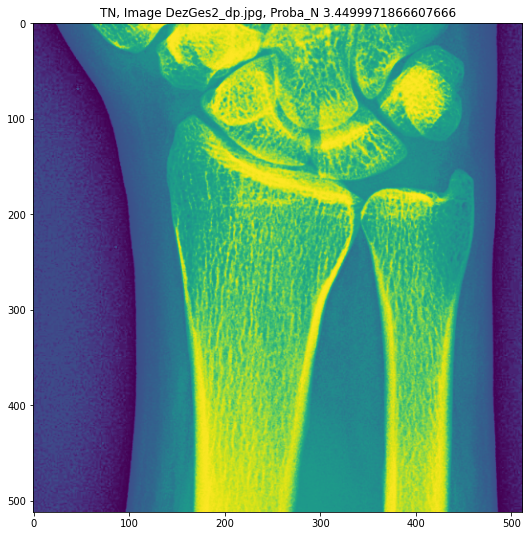

[INFO] Transformer: Augment_Normalize


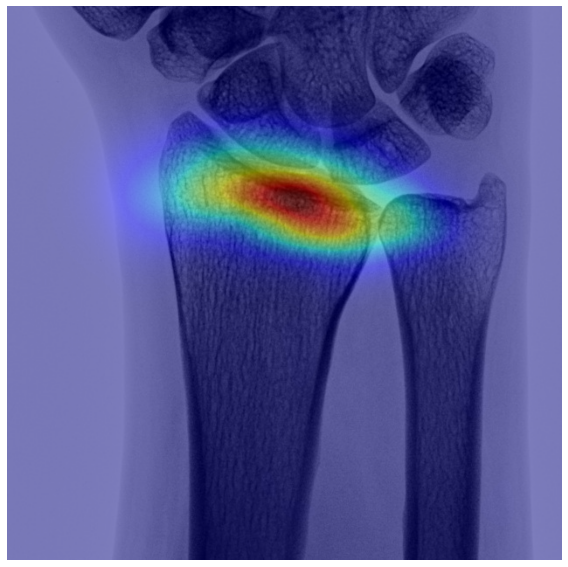

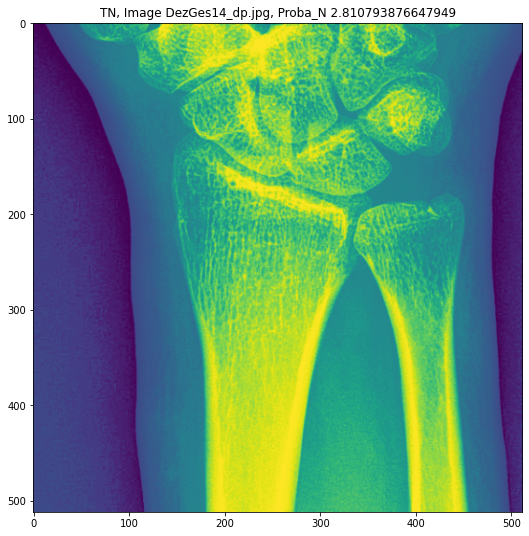

[INFO] Transformer: Augment_Normalize


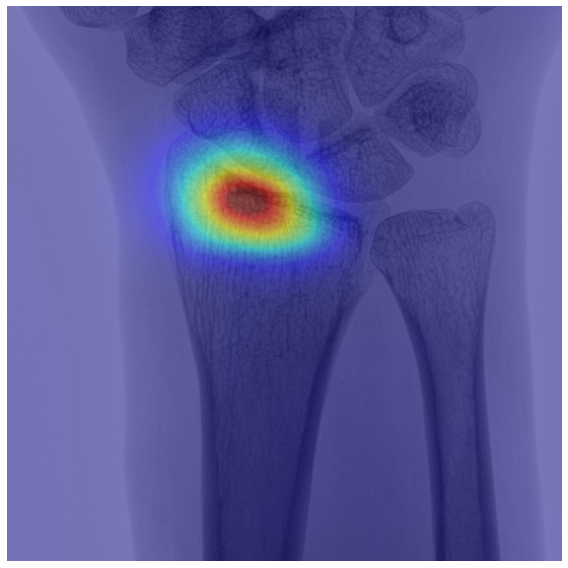

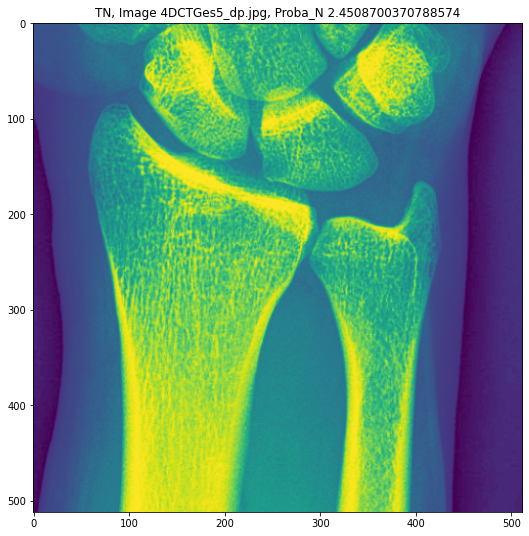

[INFO] Transformer: Augment_Normalize


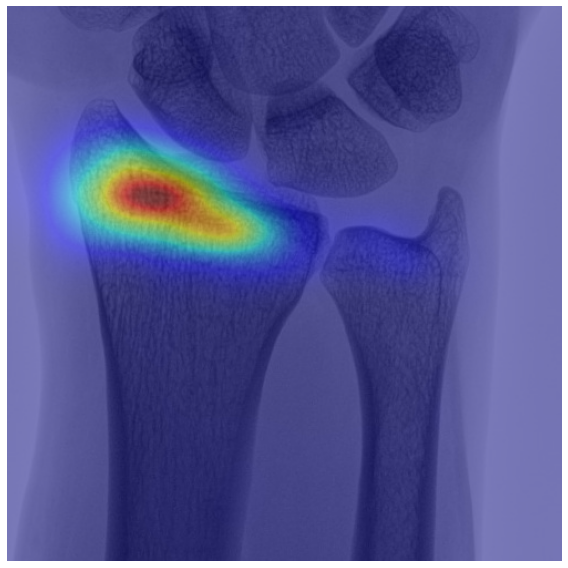

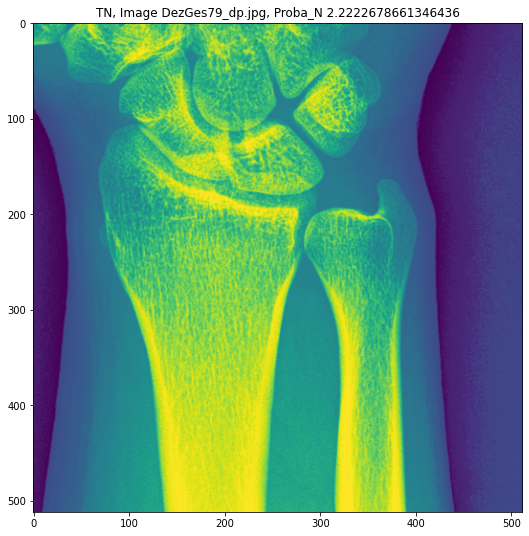

[INFO] Transformer: Augment_Normalize


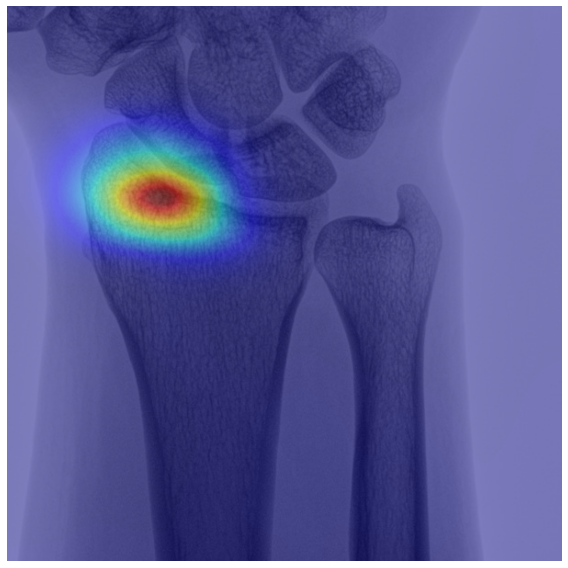

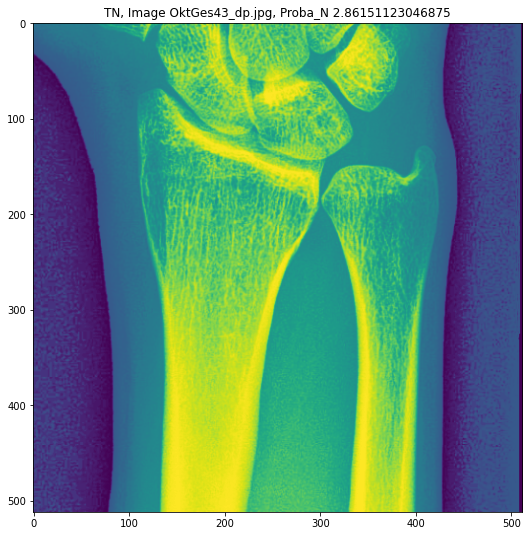

[INFO] Transformer: Augment_Normalize


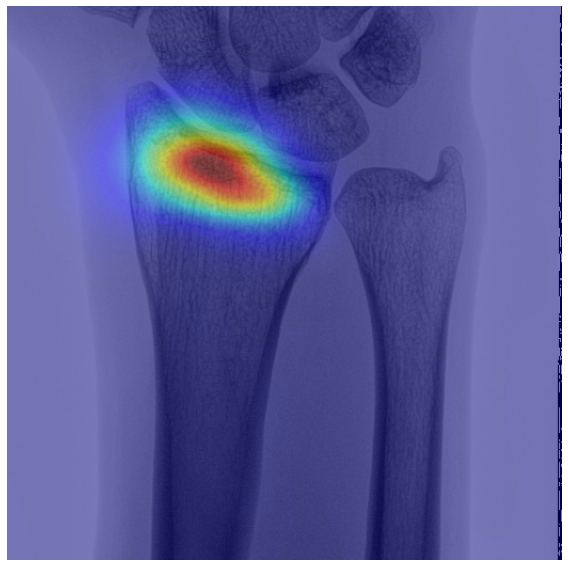

In [31]:
N = 10
top_true_positives = df_result[(df_result['true'] == 0) & (df_result['pred'] == 0)].sort_values(by='proba_n', ascending=False).index[:N]

for i, data in enumerate(test_data):
    if i in top_true_positives:
        plt.figure(figsize=(9,9))
        plt.imshow(data[0].squeeze(0).squeeze(0))
        name = df.iloc[i]['filenames']
        plt.title(f'TN, Image {name}, Proba_N {df_result.iloc[i]["proba_n"]}')
        plt.show()
        GradCam()